# Powers and waves

In [1]:
%run ../setup.ipynb

Now that we've seen how complex numbers behave when multiplied together, we might also wonder what happens when a complex number is multiplied by itself repeatedly.
Of specific importance in signal processing is the sequence

$$
z^0, z^1, z^2, \cdots, z^n, \cdots
$$

If we pick an arbitrary point in this sequence, $z^n$ for some $n\geq 0$, we can express the corresponding term in polar form as follows

$$
z^n = {\left(r\cdot e^{\mathsf{j}\theta}\right)}^n = r^n \cdot e^{\mathsf{j} \cdot n \theta},
$$

where $z = r\cdot e^{\mathsf{j}\theta}$ and the second equality follows from the product rule for exponents.

From this, we can see that the $n$th step in the sequence will place the point at angle $n\cdot \theta$, and radius $r^n$.

If $r < 1$, this sequence will have decreasing radius, and it will spiral into the origin.
If $r > 1$, the sequence will have increasing radius, and it will spiral out.
If $r=1$, each element will have the same radius since $1^n = 1$: the sequence will therefore loop around the circle indefinitely.

If $0 \leq \theta \leq \pi$, the spiral will wind counter-clockwise, and otherwise it will wind clockwise, as demonstrated below.
Larger angles (closer to $\pm\pi$) rotate faster than smaller angles (closer to $0$).

In [2]:
%%capture
# Animated plot of spiraling complex exponentials

Nmax = 20
frame_rate = 25

n_frames = Nmax * frame_rate
duration = n_frames // frame_rate

fig, ax = plt.subplots(figsize=figaspect(0.75))
circ = patches.Ellipse((0, 0), 2, 2, edgecolor='k', linewidth=3, fill=False, zorder=-4)
ax.add_artist(circ)
ax.axhline(0, color=colors[3], zorder=-4, linewidth=2)
ax.axvline(0, color=colors[3], zorder=-4, linewidth=2)

ax.set_xlabel(r'Real axis $\leftrightarrow$')
ax.set_ylabel(r'Imaginary axis  $\leftrightarrow$');

z1 = 0.9 * np.exp(1.j * 3 * np.pi/4)
z2 = 1.1 * np.exp(-1.j * np.pi/6)
z3 = np.exp(1.j * np.pi/3)


n = np.arange(Nmax)

d1 = z1**n
d2 = z2**n
d3 = z3**n

curve = np.linspace(0, n.max(), num=int(duration*frame_rate))
c1 = z1**curve
c2 = z2**curve
c3 = z3**curve

p1 = ax.plot([z1.real], [z1.imag], label=r'$r=0.9$, $\theta=3\pi/4$',
           marker='o', markersize=15, linewidth=0, color=colors[0])[0]
pd1 = ax.plot(d1.real, d1.imag, marker='o', markersize=7, linewidth=0, color=colors[0], visible=False)[0]
pc1 = ax.plot(c1.real, c1.imag, linewidth=2, zorder=-1, color=colors[0], linestyle='--', visible=False)[0]

p2 = ax.plot([z2.real], [z2.imag], label=r'$r=1.1$, $\theta=-\pi/6$',
           marker='o', markersize=15, linewidth=0, color=colors[1])[0]
pd2 = ax.plot(d2.real, d2.imag, marker='o', markersize=7, linewidth=0, color=colors[1], visible=False)[0]
pc2 = ax.plot(c2.real, c2.imag, linewidth=2, zorder=-1, color=colors[1], linestyle='--', visible=False)[0]

p3 = ax.plot([z3.real], [z3.imag], label=r'$r=1$, $\theta=\pi/3$',
           marker='o', markersize=15, linewidth=0, color=colors[2])[0]
pd3 = ax.plot(d3.real, d3.imag, marker='o', markersize=7, linewidth=0, color=colors[2], visible=False)[0]
pc3 = ax.plot(c3.real, c3.imag, linewidth=2, zorder=-1, color=colors[2], linestyle='--', visible=False)[0]

pn = ax.text(-1.75, -1.75, r"$z^{" + '{:d}'.format(1) + r"}$", color=colors[4], size=25, visible=False)
plt.legend(loc='upper right', labelcolor='linecolor')
ax.set_aspect('equal')
ax.set_xlim([-2, 2])
ax.set_ylim([-2, 2]);

def init():
    pc1.set_visible(True)
    pc2.set_visible(True)
    pc3.set_visible(True)
    pd1.set_visible(True)
    pd2.set_visible(True)
    pd3.set_visible(True)
    pn.set_visible(True)
    return pc1, pc2, pc3, pd1, pd2, pd3, pn

def animate(frame):
    n = frame // frame_rate
    pc1.set_data(c1.real[:frame+1], c1.imag[:frame+1])
    pc2.set_data(c2.real[:frame+1], c2.imag[:frame+1])
    pc3.set_data(c3.real[:frame+1], c3.imag[:frame+1])
    pd1.set_data(d1.real[:n+1], d1.imag[:n+1])
    pd2.set_data(d2.real[:n+1], d2.imag[:n+1])
    pd3.set_data(d3.real[:n+1], d3.imag[:n+1])
    pn.set_text(r"$z^{" + '{:d}'.format(int(curve[frame])) + r"}$")
    return pc1, pc2, pc3, pd1, pd2, pd3, pn

animation = FuncAnimation(fig, animate, init_func=init,
                         frames=np.arange(n_frames),
                         interval=1000/frame_rate, blit=True)
glue('zexp', animation, display=False)

In [3]:
animation

```{glue:figure} zexp

Raising a complex number $z$ to a sequence of powers $n=0, 1, 2, \dots$ produces an inward spiral (if magnitude is less than 1); an outward spiral (if magnitude is greater than 1), or an orbit around the unit circle (if magnitude is exactly 1).
```

If we take just the real (or imaginary) part of $z^n$ for the sequence of values of $n$, we'll see a sinusoid with decaying ($r < 1$), increasing ($r>1$), or stable ($r=1$) amplitude, as illustrated below for the real part (top) and imaginary part (bottom).

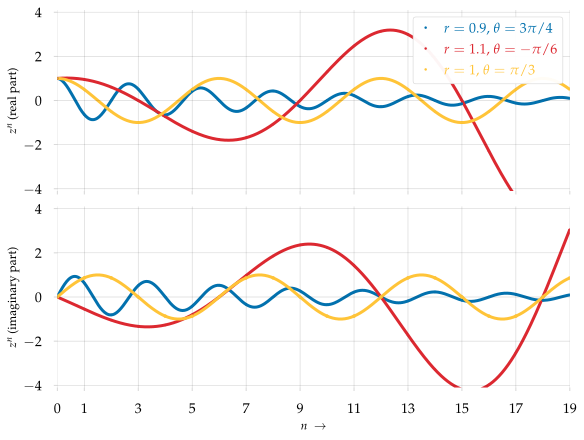

In [4]:
fig, (ax, ax2) = plt.subplots(nrows=2, sharex=True, sharey=True, figsize=figaspect(0.75))

ax.plot(n, d1.real, marker='.', label=r'$r=0.9$, $\theta=3\pi/4$', linewidth=0, color=colors[0])
ax.plot(curve, c1.real,  zorder=-1, color=colors[0])

ax.plot(n, d2.real, marker='.', label=r'$r=1.1$, $\theta=-\pi/6$', linewidth=0, color=colors[1])
ax.plot(curve, c2.real, zorder=-1, color=colors[1])

ax.plot(n, d3.real, label=r'$r=1$, $\theta=\pi/3$', marker='.', linewidth=0, color=colors[2])
ax.plot(curve, c3.real, zorder=-1, color=colors[2])
ax.set_xlim([0, 19])
ax.set_ylim([-2, 2])
ax.set_xlabel(r'$n~\rightarrow$')
ax.set_ylabel(r'$z^n$ (real part)');
ax.legend(loc='upper right', labelcolor='linecolor');
ax.label_outer()

ax2.plot(n, d1.imag,marker='.',  linewidth=0, color=colors[0])
ax2.plot(curve, c1.imag, zorder=-1, color=colors[0])

ax2.plot(n, d2.imag, marker='.', linewidth=0, color=colors[1])
ax2.plot(curve, c2.imag, zorder=-1, color=colors[1])

ax2.plot(n, d3.imag, marker='.', markersize=7, linewidth=0, color=colors[2])
ax2.plot(curve, c3.imag, zorder=-1, color=colors[2])
ax2.set_ylim([-4.1, 4.1])
ax2.set_xticks([0, 1, 3, 5, 7, 9, 11, 13, 15, 17, 19])
ax2.set_xlabel(r'$n~\rightarrow$')
ax2.set_ylabel(r'$z^n$ (imaginary part)');
ax2.label_outer();
glue('zwave', fig, display=False)

```{glue:figure} zwave

The real (top) and imaginary (bottom) components of $z^n$ as $n$ grows, for different choices of $z$.
```

From these plots, we can see that any complex number $z$ can be used to generate what is known as a **complex sinusoid** by raising it to successive powers $z^n$.
This idea forms the basis of the (discrete) Fourier transform, which we will see in the next chapter.